# KMeans

In [1]:
import numpy as np
import sys
sys.path.append("..")
from function.function import loadData, show_data, preprocessing, showDistribution, removenans, crossplot, kMeans, Kmeans_cluster_scores
from function.function import plotResult, plotInputData, input_deleteNan, plot_dimensionality_reduction, crossplot_result, plot_cluster_distribution
from function.function import calculateAmi, calculateAri, calculateVm

## Load Data

In [2]:
data = np.load('../syntheticData/Model5b/output_fields_smooth.npz')

data_list = loadData(data)


## Plot Input Data

Using function show_data() to draw each parameter of input data. 

There are three parameters of show_data(), which are dataset, the number of rows and the number of columns.

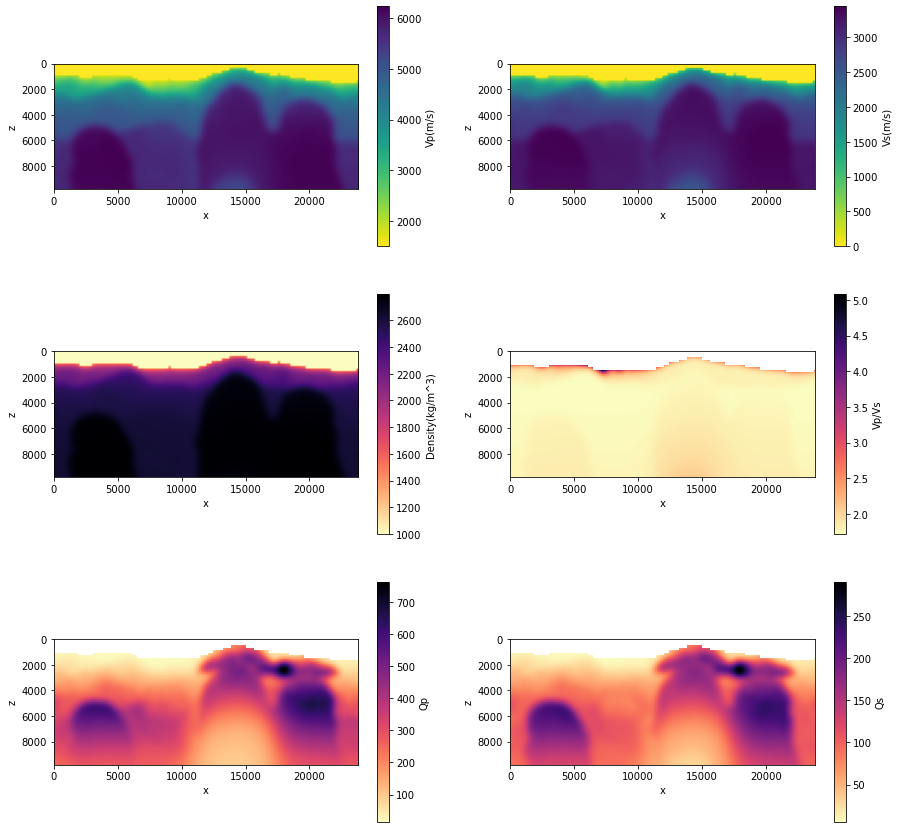

In [3]:
show_data(data_list,3,2)

Using removenans() to remove points with nan values from array. 

- new_data is the original data saved in the form of np.array.

- data_noNan removes nan values from new_data. 

- nan_list is the list of nan values index.

In [4]:
new_data,data_noNan,nan_list = removenans(data)

Using showDistribution() to show the distribution of each parameter. Since the last two parameters of new_data is 'x' and 'z', we only use new_data[:,:-2]

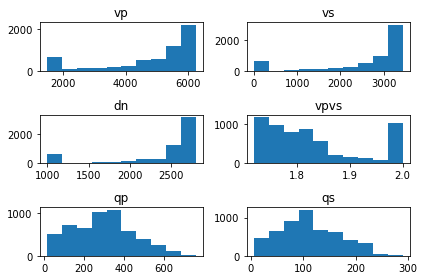

In [5]:
showDistribution(new_data[:,:-2])

Using crossplot to plot the cross-plot (scatter plot) of each pair of physical properties (other parameters and vp)

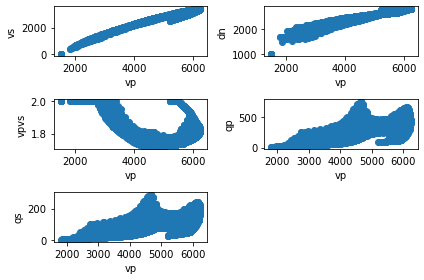

In [6]:
crossplot(new_data)

## Data Preprocessing

Using preprocessing() to make data standardized

In [7]:
# remove the mean
# divide by the variance

data_preprocessing = preprocessing(data_noNan) 


## Plot Data after Preprocessing

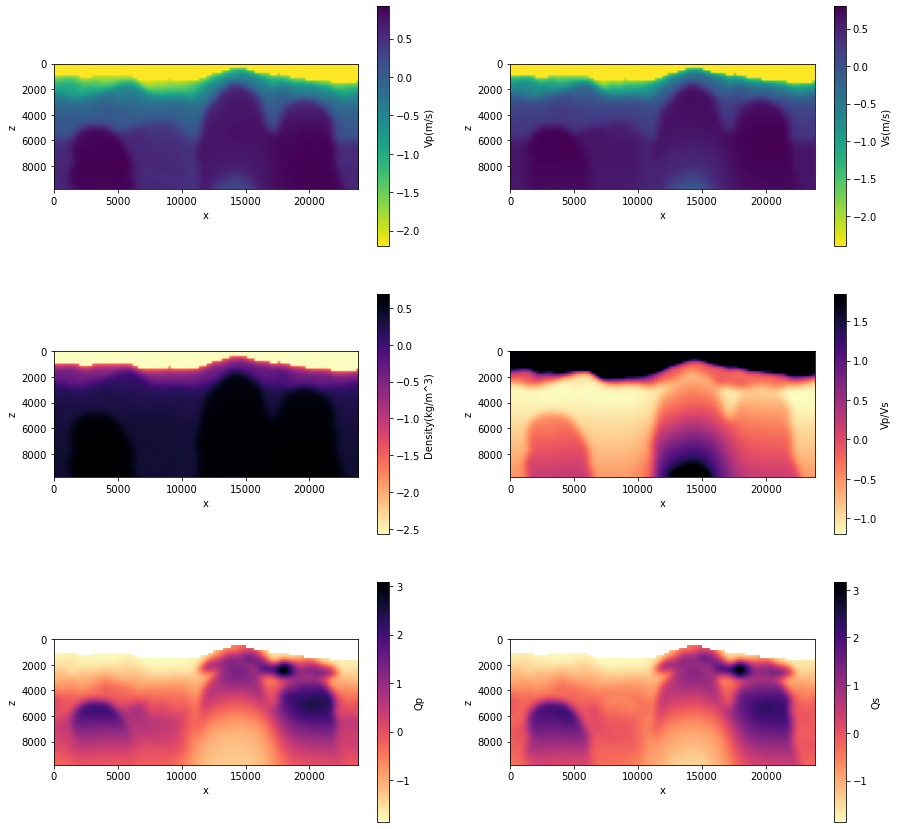

In [8]:
data_list = []
data1 = preprocessing(new_data)
for i in range(data_preprocessing.shape[1]-2):
    data_list.append(data1[:,i].reshape(50,120))
show_data(data_list,3,2)

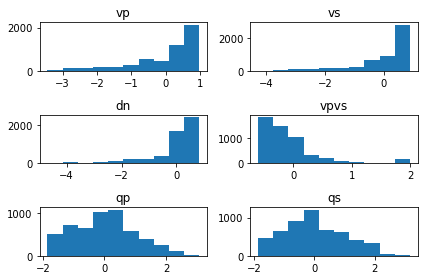

In [9]:
showDistribution(data_preprocessing[:,:-2])

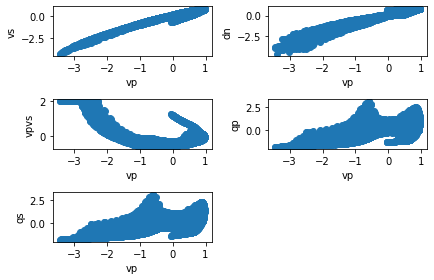

In [10]:
crossplot(data_preprocessing)

## KMeans

Using KMeans() to divide data in clusters.

- result_k is the result of KMeans and data_preprocessing is normalized data with no nan value

Using plotResult() to show the result of clusters.

- data is the original input data
- result_k is labels for data without nan values after KMeans

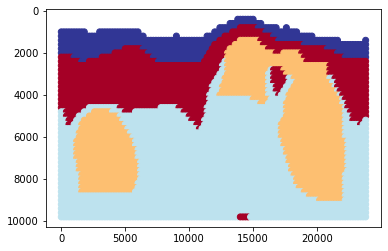

In [11]:
result_k = kMeans(4, data_preprocessing[:,:-2])
plotResult(data_noNan,result_k)

## Tuning Parameters

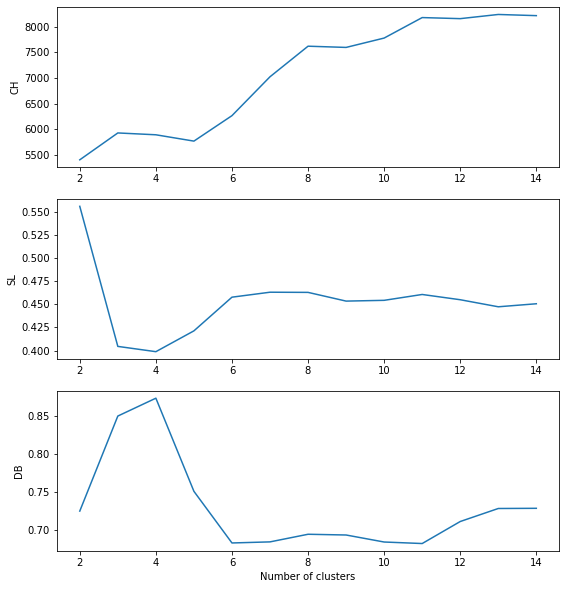

In [12]:
Kmeans_cluster_scores(data_preprocessing[:,:-2])

## Input Data

Loading and plotting input data.

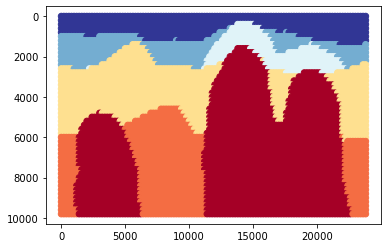

In [13]:
input_data = np.load('../syntheticData/Model5b/input_fields.npz')
plotInputData(input_data)

In [14]:
input_label = input_data['classes'].reshape(-1)
input_delete = input_deleteNan(input_label, nan_list)

## Validation (using V-measure)

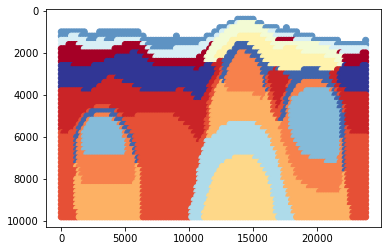

V-measure is  0.5892246767207187


In [15]:
result_k = kMeans(14, data_preprocessing[:,:-2])
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ", vm)

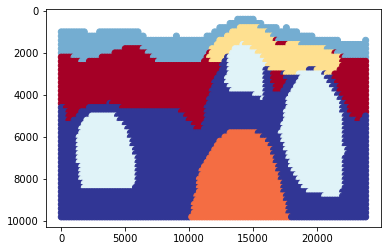

V-measure is  0.5720140093347829


In [16]:
result_k = kMeans(6, data_preprocessing[:,:-2])
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ", vm)

## Choosing result of best parameters.
Kmeans() have two parameters.
- The first one is the number of clusters.
- The second one is dataset.

In [17]:
result_k = kMeans(14, data_preprocessing[:,:-2])

## Dimensionality Reduction

Using plot_dimensionality_reduction() to plot the cluster result after dimensionality reduction.

It has two parameters:

- The first one is dataset
- The second one is cluster result

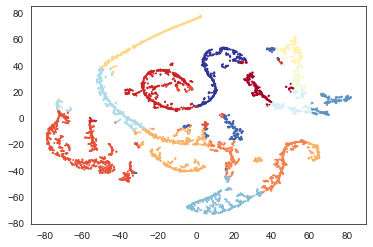

In [18]:
plot_dimensionality_reduction(data_preprocessing[:,:-2],result_k)

## Result Crossplot

crossplot_result has two parameters.
- The first one is dataset with no nan values.
- The second one is clustering result.

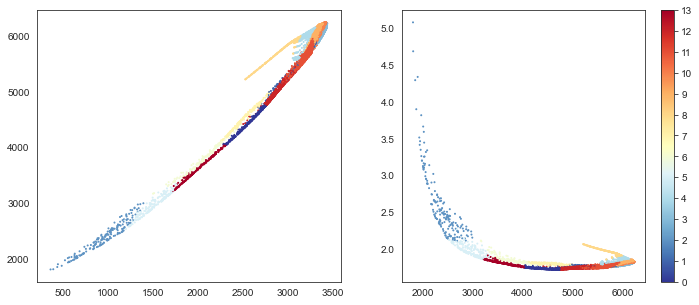

In [19]:
crossplot_result(data_noNan, result_k)

## Cluster Distribution

Using plot_cluster_distribution() to plot the distribution of clusters.

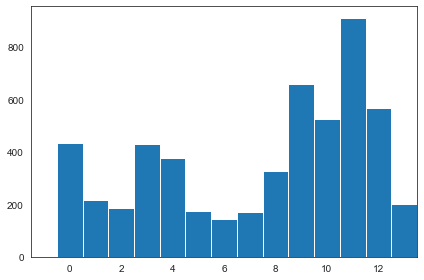

In [20]:
plot_cluster_distribution(result_k)

## Compare Result with Input Data

### Adjusted Rand Index

Using calculateAri() to calculate adjusted rand index for two cluster results.

In [21]:
ari_k = calculateAri(result_k, input_delete)
print("Adjusted Rand Index of KMeans is ", ari_k)

Adjusted Rand Index of KMeans is  0.3318016828535029


### Adjusted Mutual Information

Using calculateAmi() to calculate adjusted mutual information for two cluster results.

In [22]:
ami_k = calculateAmi(result_k, input_delete)
print("Adjusted Mutual Information of KMeans is ", ami_k)

Adjusted Mutual Information of KMeans is  0.5881803692125834


## Testing with Various Input Parameters

Testing with different sets of characteristics.

Dataset has 8 characteristics called Vp, Vs, Density, Vp/Vs, Qp, Qs, x, z, and the index of them is 0, 1, 2, 3, 4, 5, 6, 7.

In [23]:
testData1 = data_preprocessing[:,[0,1,3]]
testData2 = data_preprocessing[:,[0,2,4]]
testData3 = data_preprocessing[:,[0,1]]

- testData1 selects Vp, Vs and Vp/Vs.
- testData2 selects Vp, Density and Qp.
- testData3 selectes Vp and Vs.

## Vp, Vs, Vp/Vs

### KMeans

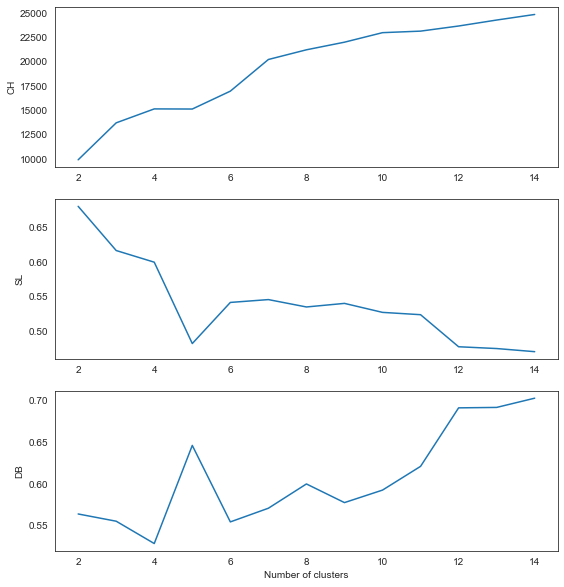

In [24]:
Kmeans_cluster_scores(testData1)

## Validation

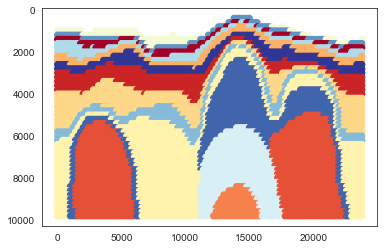

V-measure is  0.5468361860183485


In [25]:
result_k = kMeans(14, testData1)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

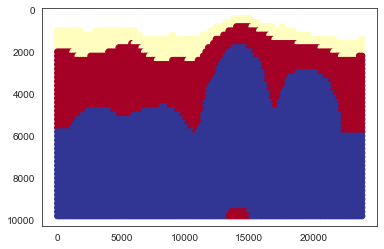

V-measure is  0.5895462141244058


In [26]:
result_k = kMeans(3, testData1)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

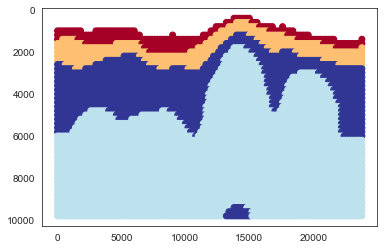

V-measure is  0.5959639178650379


In [27]:
result_k = kMeans(4, testData1)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ", vm)

## Choosing result of best parameters.
Kmeans() have two parameters.
- The first one is the number of clusters.
- The second one is dataset.

In [28]:
result_k = kMeans(4, testData1)

## Dimensionality Reduction

Using plot_dimensionality_reduction() to plot the cluster result after dimensionality reduction.

It has two parameters:

- The first one is dataset
- The second one is cluster result

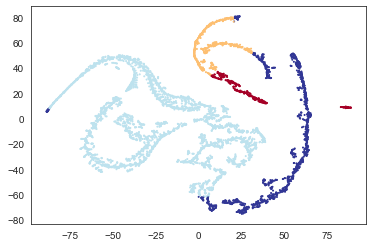

In [29]:
plot_dimensionality_reduction(testData1,result_k)

## Result Crossplot

crossplot_result has two parameters.
- The first one is dataset with no nan values.
- The second one is clustering result.

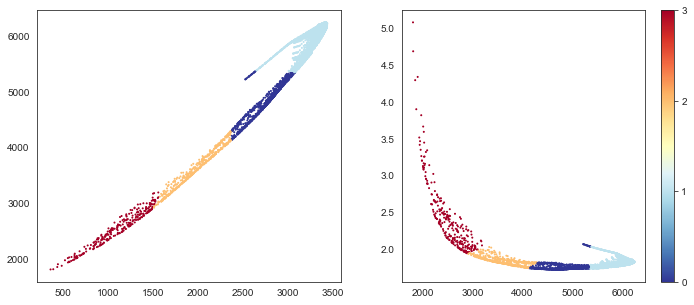

In [30]:
crossplot_result(data_noNan, result_k)

## Cluster Distribution

Using plot_cluster_distribution() to plot the distribution of clusters.

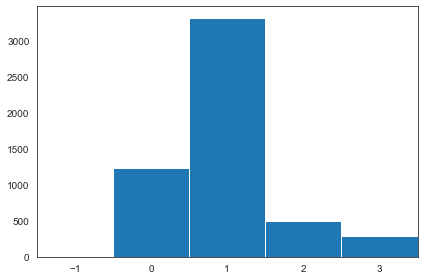

In [31]:
plot_cluster_distribution(result_k)

## Compare KMeans with Input Data

### Adjusted Rand Index

Using calculateAri() to calculate adjusted rand index for two cluster results.

In [32]:
ari_k = calculateAri(result_k, input_delete)
print("Adjusted Rand Index of KMeans is ", ari_k)

Adjusted Rand Index of KMeans is  0.5504776807691981


### Adjusted Mutual Information

Using calculateAmi() to calculate adjusted mutual information for two cluster results.

In [33]:
ami_k = calculateAmi(result_k, input_delete)
print("Adjusted Mutual Information of KMeans is ", ami_k)

Adjusted Mutual Information of KMeans is  0.5955826278571896


## Vp, Density, Qp

### KMeans

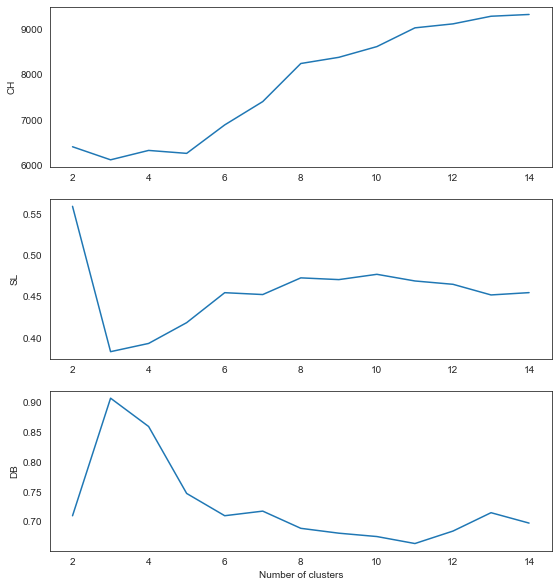

In [34]:
Kmeans_cluster_scores(testData2)

## Validation

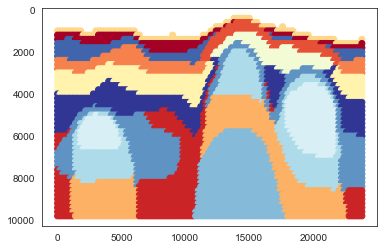

V-measure is  0.5872509067043387


In [35]:
result_k = kMeans(14, testData2)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

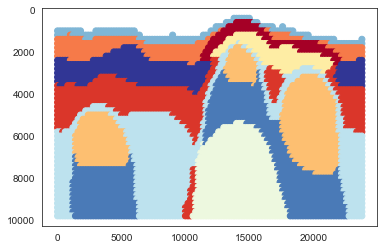

V-measure is  0.623600291661572


In [36]:
result_k = kMeans(10, testData2)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

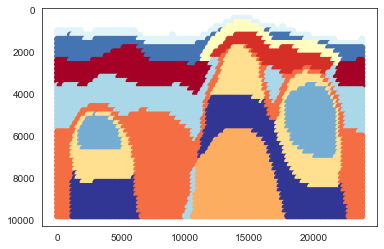

V-measure is  0.5977086037913726


In [37]:
result_k = kMeans(11, testData2)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

## Choosing result of best parameters.
Kmeans() have two parameters.
- The first one is the number of clusters.
- The second one is dataset.

In [38]:
result_k = kMeans(11, testData2)

## Dimensionality Reduction

Using plot_dimensionality_reduction() to plot the cluster result after dimensionality reduction.

It has two parameters:

- The first one is dataset
- The second one is cluster result

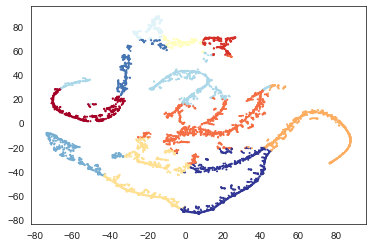

In [39]:
plot_dimensionality_reduction(testData2,result_k)

## Result Crossplot

crossplot_result has two parameters.
- The first one is dataset with no nan values.
- The second one is clustering result.

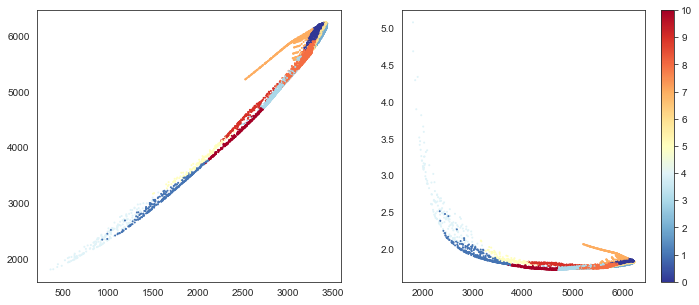

In [40]:
crossplot_result(data_noNan, result_k)

## Cluster Distribution

Using plot_cluster_distribution() to plot the distribution of clusters.

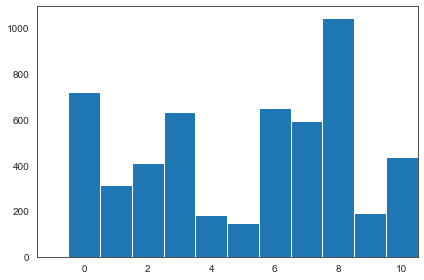

In [41]:
plot_cluster_distribution(result_k)

## Compare KMeans with Input Data

### Adjusted Rand Index

Using calculateAri() to calculate adjusted rand index for two cluster results.

In [42]:
ari_k = calculateAri(result_k, input_delete)
print("Adjusted Rand Index of KMeans is ", ari_k)

Adjusted Rand Index of KMeans is  0.3635059718671585


### Adjusted Mutual Information

Using calculateAmi() to calculate adjusted mutual information for two cluster results.

In [43]:
ami_k = calculateAmi(result_k, input_delete)
print("Adjusted Mutual Information of KMeans is ", ami_k)

Adjusted Mutual Information of KMeans is  0.5968718212010076


## Vp, Vs

### KMeans

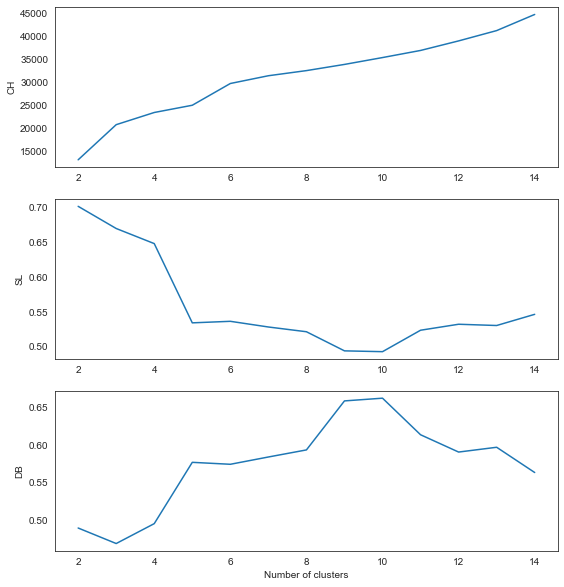

In [44]:
Kmeans_cluster_scores(testData3)

## Validation

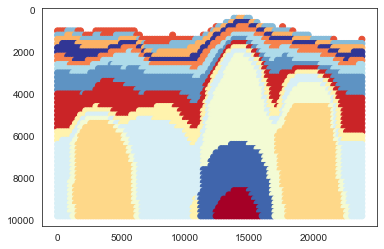

V-measure is  0.5477341282151187


In [45]:
result_k = kMeans(14, testData3)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

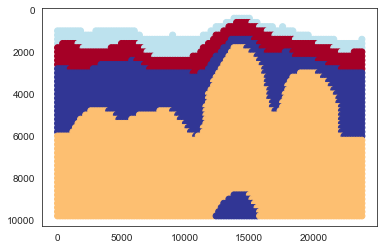

V-measure is  0.5745304654244598


In [46]:
result_k = kMeans(4, testData3)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

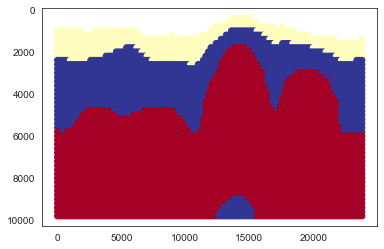

V-measure is  0.5903961042750432


In [47]:
result_k = kMeans(3, testData3)
plotResult(data_noNan, result_k)
vm = calculateVm(result_k, input_delete)
print("V-measure is ",vm)

## Choosing result of best parameters.
Kmeans() have two parameters.
- The first one is the number of clusters.
- The second one is dataset.

In [48]:
result_k = kMeans(3, testData3)

## Dimensionality Reduction

Using plot_dimensionality_reduction() to plot the cluster result after dimensionality reduction.

It has two parameters:

- The first one is dataset
- The second one is cluster result

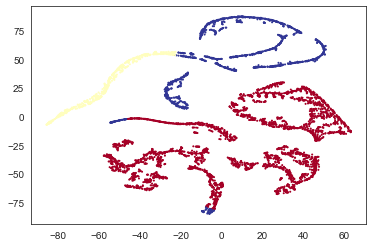

In [49]:
plot_dimensionality_reduction(testData3,result_k)

## Result Crossplot

crossplot_result has two parameters.
- The first one is dataset with no nan values.
- The second one is clustering result.

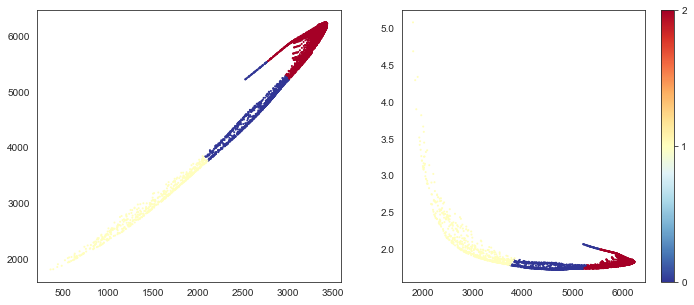

In [50]:
crossplot_result(data_noNan, result_k)

## Cluster Distribution

Using plot_cluster_distribution() to plot the distribution of clusters.

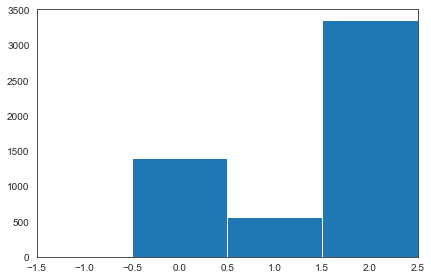

In [51]:
plot_cluster_distribution(result_k)

## Compare KMeans with Input Data

### Adjusted Rand Index

Using calculateAri() to calculate adjusted rand index for two cluster results.

In [52]:
ari_k = calculateAri(result_k, input_delete)
print("Adjusted Rand Index of KMeans is ", ari_k)

Adjusted Rand Index of KMeans is  0.5265097579513192


### Adjusted Mutual Information

Using calculateAmi() to calculate adjusted mutual information for two cluster results.

In [53]:
ami_k = calculateAmi(result_k, input_delete)
print("Adjusted Mutual Information of KMeans is ", ami_k)

Adjusted Mutual Information of KMeans is  0.5901243213227604
